In [23]:
import pandas as pd
from Scaling import normalize, standardize
import plotly.express as px
from sklearn.cluster import KMeans
from matplotlib import pyplot as plt
import numpy as np

    
df2015 = pd.read_csv('../data/kaasa/kaasa_2015.csv', index_col=None, header=0)
df2016 = pd.read_csv('../data/kaasa/kaasa_2016.csv', index_col=None, header=0)
df2017 = pd.read_csv('../data/kaasa/kaasa_2017.csv', index_col=None, header=0)
df2018 = pd.read_csv('../data/kaasa/kaasa_2018.csv', index_col=None, header=0)
df2019 = pd.read_csv('../data/kaasa/kaasa_2019.csv', index_col=None, header=0)
df2020 = pd.read_csv('../data/kaasa/kaasa_2020.csv', index_col=None, header=0)
df2021 = pd.read_csv('../data/kaasa/kaasa_2021.csv', index_col=None, header=0)

files = [df2015, df2016, df2017, df2018, df2019, df2020, df2021]

df_tot = pd.concat(files, axis=0, ignore_index=True)
df_tot['date_time'] = pd.to_datetime(df_tot['date_time'])

data_kmeans = df_tot.loc[:,[ 'altitude', 'velocity','angle']]

X_S = standardize(data_kmeans, ['angle', 'velocity', 'altitude']) # standarize the data
X = normalize(X_S, ['angle', 'velocity', 'altitude'],0,1) # standarize the data
print(X)


           angle  velocity  altitude
0       0.000000  0.000000  0.089153
1       0.919609  0.000000  0.089181
2       0.862001  0.000068  0.089171
3       0.980134  0.003249  0.099441
4       0.543867  0.002640  0.087970
...          ...       ...       ...
239439  0.881996  0.041024  0.528836
239440  0.128054  0.034660  0.557840
239441  0.249907  0.037706  0.578035
239442  0.597979  0.029921  0.596797
239443  0.000000  0.048944  0.559832

[239444 rows x 3 columns]


In [24]:

def ElbowMethod(df):
    score = []
    for i in range(1, 21):
        kmeans = KMeans(n_clusters=i, max_iter=1000,  n_init=10).fit(df)
        df['clusters'] = kmeans.labels_
        score.append(kmeans.inertia_)
    plt.figure(figsize=(8, 4))
    plt.plot(range(1, 21), score)
    plt.xlabel('No. clusters')
    plt.xticks(fontsize=10, ticks=[2, 4, 6, 8,
               10, 12, 14, 16, 18, 20])
    plt.ylabel('Score')
    plt.show()


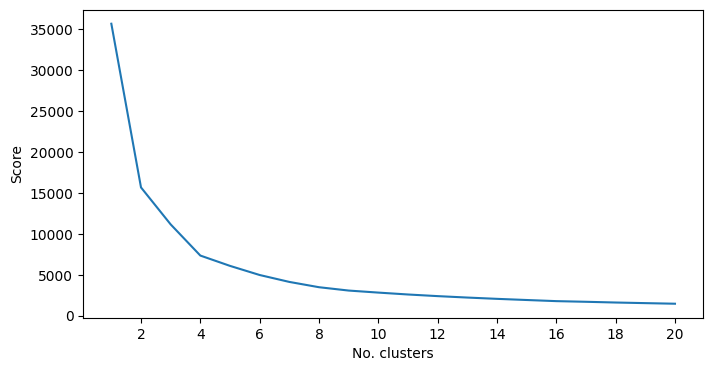

In [12]:
ElbowMethod(X)


In [25]:
kmeans = KMeans(n_clusters=4, n_init=10)
kmeans.fit(X)
clusters = kmeans.labels_ 
print('inertia:', kmeans.inertia_)
print('iterations:', kmeans.n_iter_)
print('n features:', kmeans.n_features_in_)
print('features:', kmeans.feature_names_in_)
print('features:', kmeans.feature_names_in_)


inertia: 7215.615516400753
iterations: 7
n features: 3
features: ['angle' 'velocity' 'altitude']
features: ['angle' 'velocity' 'altitude']


Index(['angle', 'velocity', 'altitude'], dtype='object')


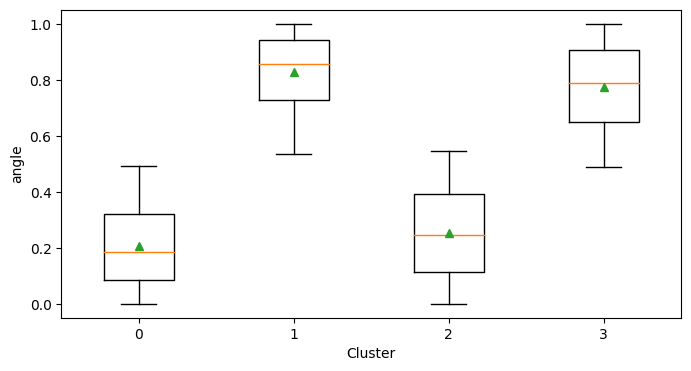

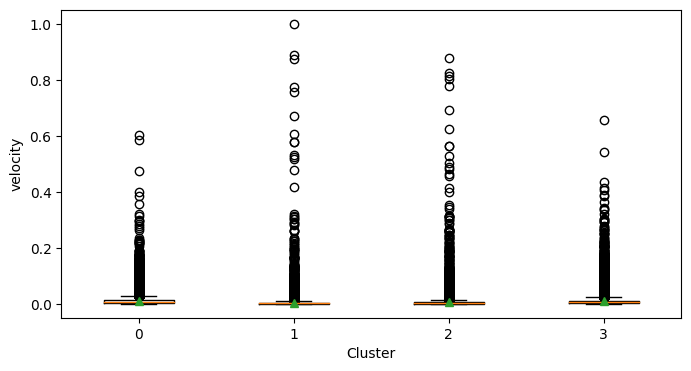

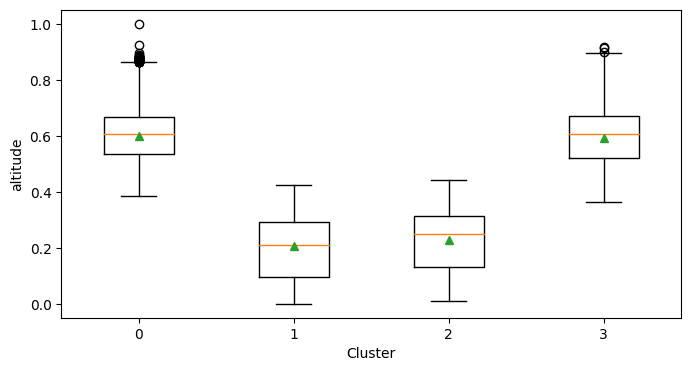

In [26]:
features = ['altitude', 'velocity', 'angle']
print(X.columns)
unique_labels = np.unique(clusters)

# Plot box plots to compare the feature values between clusters
for i, feature in enumerate(X.columns):
    fig, ax = plt.subplots(figsize=(8, 4))
    ax.boxplot([X.values[clusters == label, i] for label in unique_labels], labels=unique_labels,showfliers=True, showmeans=True)
    ax.set_xlabel('Cluster')
    ax.set_ylabel(feature)
    plt.show()


    

In [28]:
df_tot['cluster'] = clusters
df_tot = df_tot.astype({"cluster": str})

fig = px.scatter_3d(df_tot, x='longitude', y='latitude', z='cluster', color='cluster', opacity=1)
fig.show()

In [29]:
cluster_sizes = df_tot.groupby('cluster').size()

print(cluster_sizes)

df_feat = df_tot.groupby('cluster').agg(
    {'velocity': ['mean', 'std'], 'angle': ['mean', 'std'], 'altitude': ['mean', 'std']})


cluster_attack_count = df_tot[df_tot['attack'] == 1].groupby('cluster').size()
cluster_attack_count.name = 'attack_count'

df_feat = df_feat.join(cluster_attack_count, how='left')

print(df_feat)


cluster
0    55190
1    75129
2    55943
3    53182
dtype: int64
         (velocity, mean)  (velocity, std)  (angle, mean)  (angle, std)  \
cluster                                                                   
0              142.481065       223.951889      37.105791     25.211579   
1               61.181235       188.834974     148.859522     23.599259   
2               74.303148       235.965432      45.507421     28.637412   
3              126.593340       231.409282     139.139401     26.746613   

         (altitude, mean)  (altitude, std)  attack_count  
cluster                                                   
0              730.492323        92.357819           357  
1              308.606965       107.720506          1510  
2              332.007547       108.850819          1063  
3              725.429009        99.940389           456  


/var/folders/87/wz6yr1nn5ps8c055ln0_26qh0000gn/T/ipykernel_23451/247862537.py:12: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (2 levels on the left, 1 on the right)



In [30]:
# Initialize the figure object
import plotly.graph_objs as go
unique_labels = np.unique(clusters[(clusters != -1)])
print(X.columns)

fig = go.Figure()

# Loop through each cluster and add a trace to the figure
for i, label in enumerate(unique_labels):
    mask = (clusters == label)
    cluster_points = X.values[mask]
    cluster_size = len(cluster_points)

    fig.add_trace(go.Scatter3d(x=cluster_points[:, 0], y=cluster_points[:, 2], z=cluster_points[:, 1],  mode='markers',
                               marker=dict(size=2), name=f'Cluster {i}'))


fig.update_layout(
    scene=dict(
        xaxis_title='Altitude',
        yaxis_title='Angle',
        zaxis_title='Velocity',
    ),
    margin=dict(l=20, r=20, t=20, b=20),  width=800,
    height=500
)

fig.show()


Index(['angle', 'velocity', 'altitude'], dtype='object')
